In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pickle
from sklearn.metrics import confusion_matrix, classification_report, jaccard_score, precision_score
import yaml
import pandas as pd
pd.__version__

'1.0.3'

In [19]:
val = pickle.load(open('cluster_val.pkl','rb'))
y_val = pickle.load(open('cluster_y_val.pkl','rb'))
preds = pickle.load(open('FOC-DEEP-preds.pkl','rb'))
val.shape, y_val.shape, preds.shape

((178, 256, 256, 1), (178, 256, 256, 1), (178, 256, 256))

In [20]:
counts = np.unique(y_val, return_counts=True)[1]
counts/counts.sum()

array([0.93175755, 0.01765956, 0.05058289])

In [21]:
counts = np.unique(preds, return_counts=True)[1]
counts/counts.sum()

array([0.94456911, 0.01023839, 0.0451925 ])

In [23]:
#print(jaccard_score(y_val.flatten(),preds.flatten(),average='samples'))
print(jaccard_score(y_val.flatten(),preds.flatten(),average='micro'))

0.9383728655900502


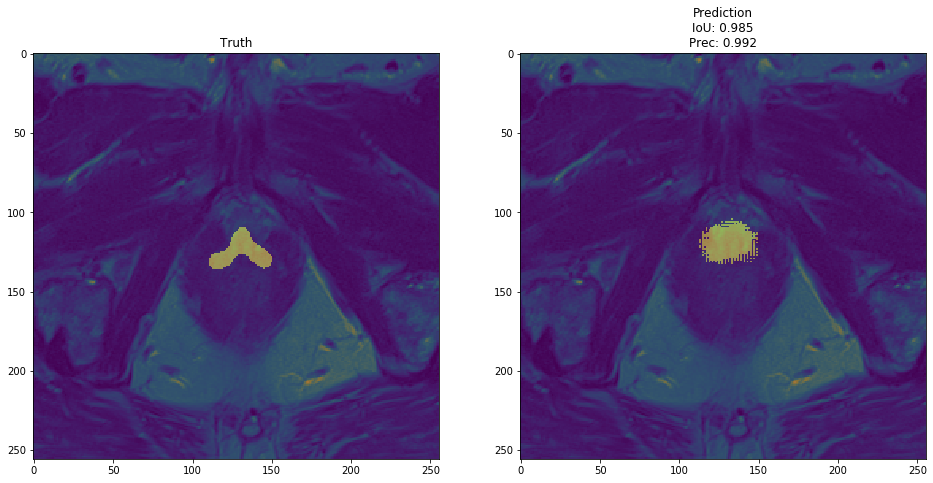

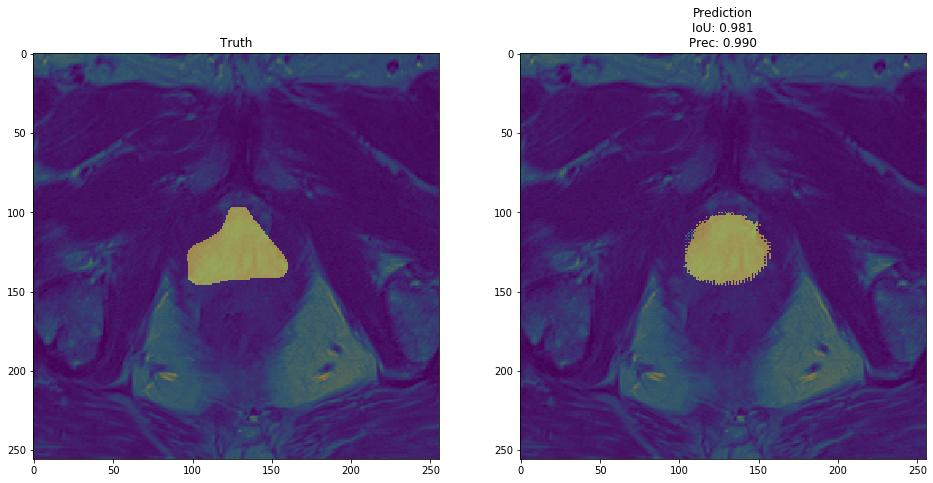

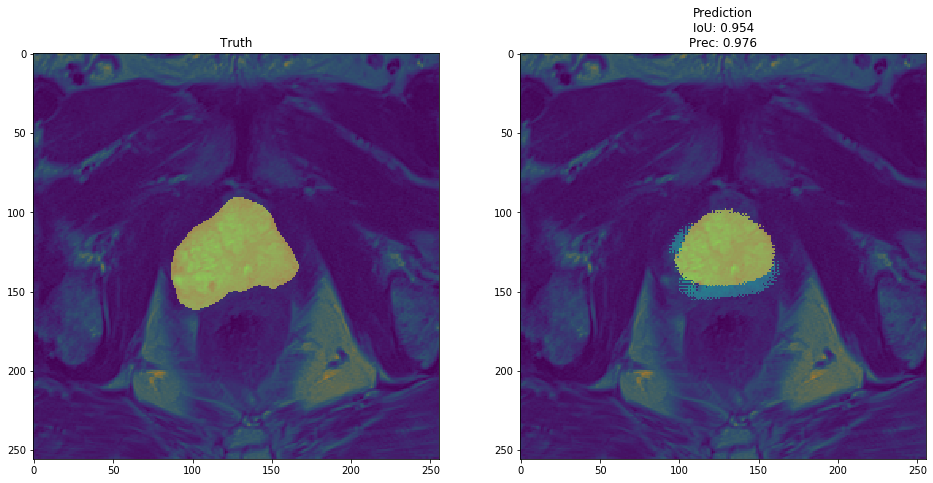

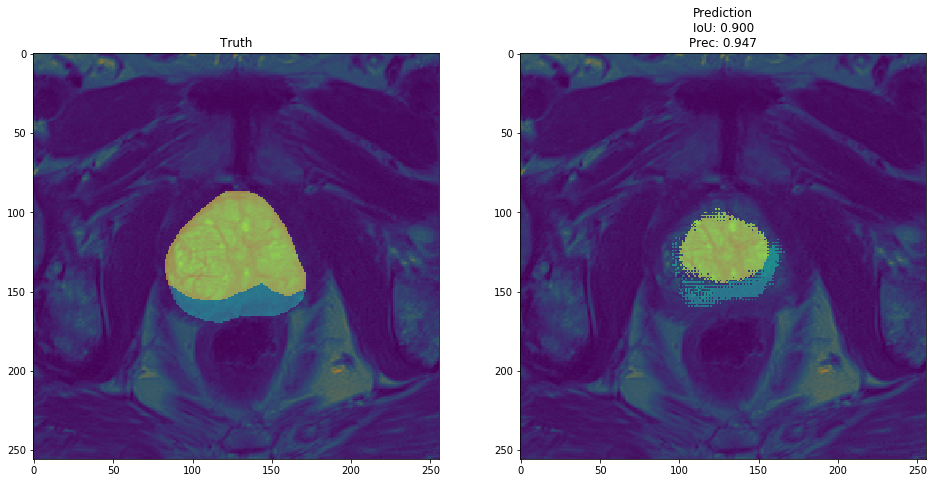

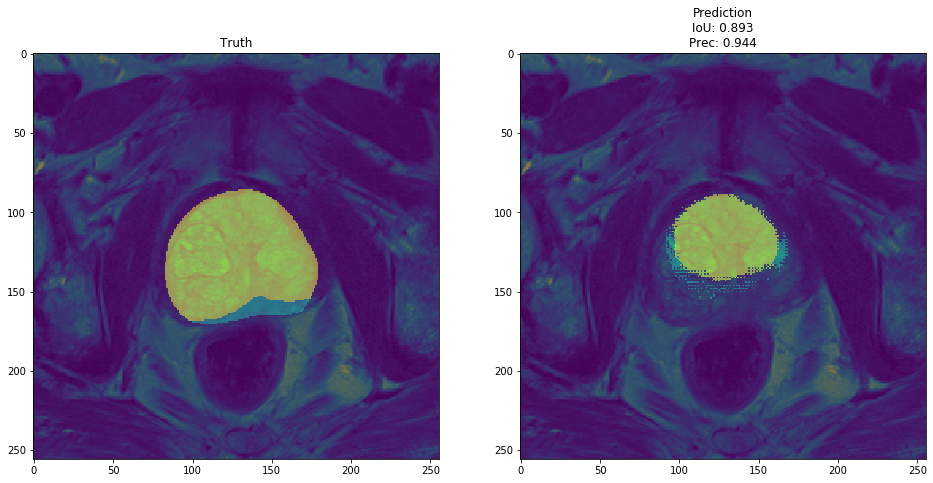

...

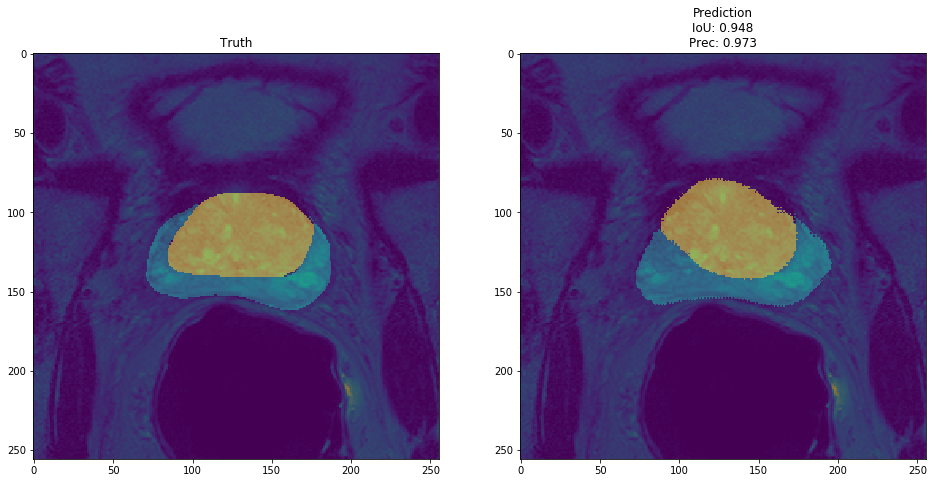

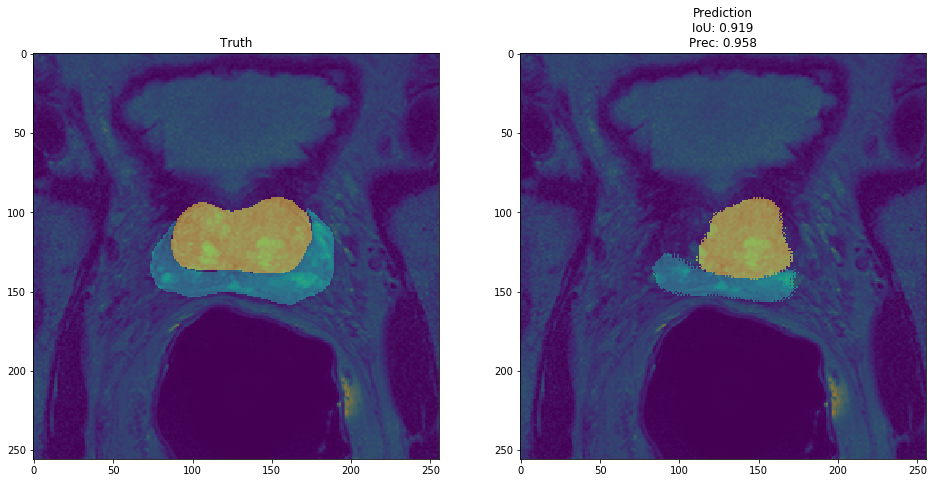

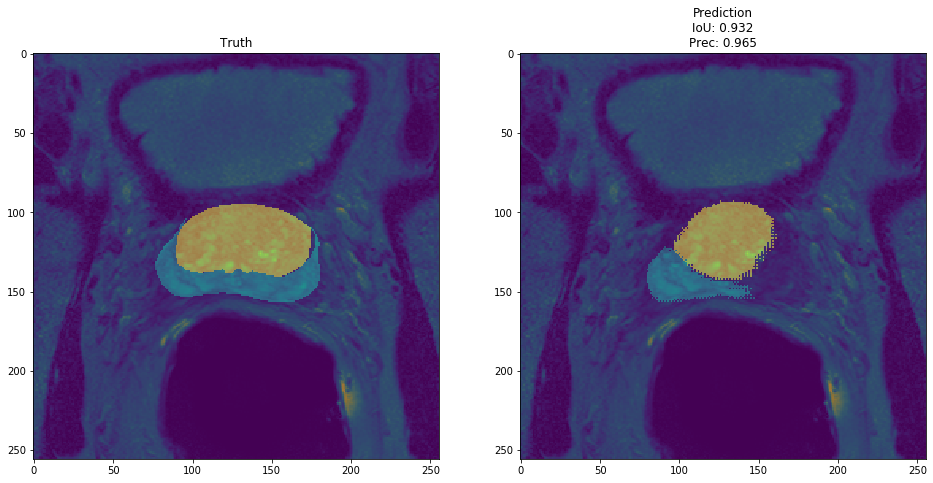

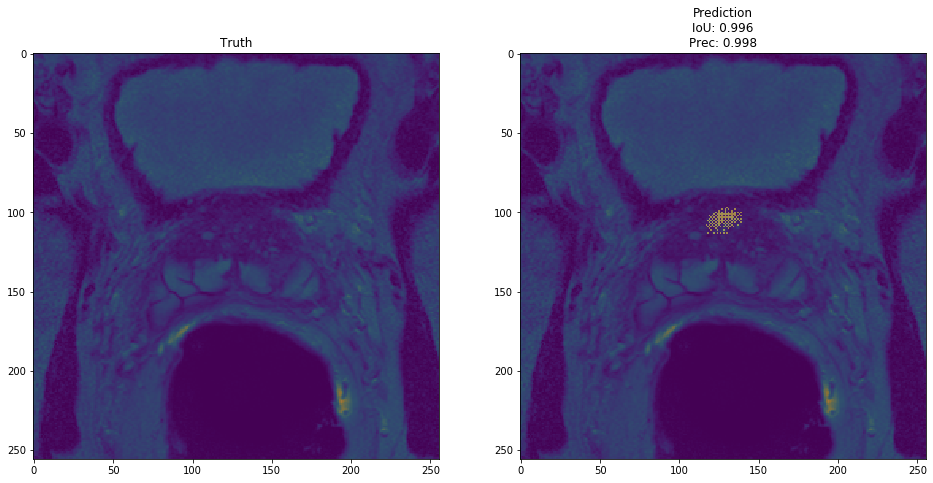

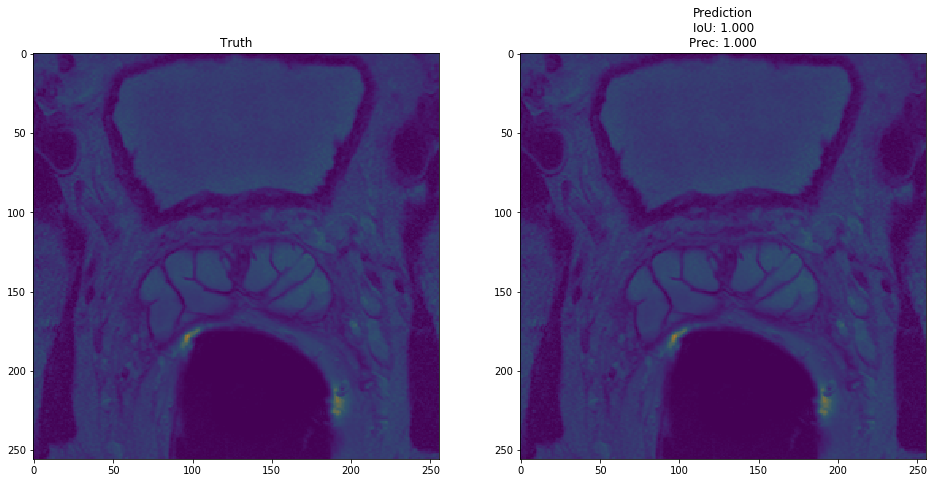

In [24]:
for i in range(178):
    idx=i
    plt.figure(figsize=(16,9))
    plt.subplot(1,2,1)
    plt.imshow(val[idx,:,:,0])
    plt.imshow(y_val[idx,:,:,0],alpha=0.5)
    plt.title('Truth')
    plt.subplot(1,2,2)
    plt.imshow(val[idx,:,:,0])
    plt.imshow(preds[idx,:,:],alpha=0.5)
    plt.title(f"Prediction\nIoU: {jaccard_score(y_val[idx,:,:,0].flatten(),preds[idx,:,:].flatten(),average='micro') :.3f}\nPrec: {precision_score(y_val[idx,:,:,0].flatten(),preds[idx,:,:].flatten(),average='micro') :.3f}")
    plt.show()

In [18]:
models = ['XE-STD','XE-DEEP','JAC-STD','JAC-DEEP','FOC-STD','FOC-DEEP','JAC-XE-STD','JAC-XE-DEEP']
for m in models:
    print(m)
    path = "./"+m+"/eval.yaml"
    results = yaml.load(open(path,'rb'))
    print(f"OP: {results['val-data']['accuracy'] :.3f}")
    print(f"PC: {results['val-data']['macro avg']['precision']:.3f}")
    print(f"Jaccard-score: {results['val-jaccard-score']:.3f}")
    print('\n')

XE-STD
OP: 0.965
PC: 0.826
Jaccard-score: 0.636


XE-DEEP
OP: 0.965
PC: 0.783
Jaccard-score: 0.633


JAC-STD
OP: 0.962
PC: 0.840
Jaccard-score: 0.591


JAC-DEEP
OP: 0.966
PC: 0.788
Jaccard-score: 0.639


FOC-STD
OP: 0.966
PC: 0.832
Jaccard-score: 0.634


FOC-DEEP
OP: 0.968
PC: 0.845
Jaccard-score: 0.655


JAC-XE-STD
OP: 0.963
PC: 0.777
Jaccard-score: 0.611


JAC-XE-DEEP
OP: 0.965
PC: 0.840
Jaccard-score: 0.631




/home/martin/miniconda3/envs/ml4h-p1-env/lib/python3.7/site-packages/ipykernel_launcher.py:5: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  """


In [2]:
import pandas as pd
d = {'a':['string 1', 'string 2 \n hello'],
     'b':['string 3\world','string 4\nmy name is']}
df = pd.DataFrame(d,index=['blabla','bla'])
df.to_markdown()

ImportError: Missing optional dependency 'tabulate'.  Use pip or conda to install tabulate.